In [1]:
import pandas as pd
import numpy as np
import requests
import json
import regex as re

In [2]:
with open("C:/Users/bevli/Downloads/NLP_exercise/tweets.txt") as f:
    read_data = f.read()

In [3]:
read_data

'{"created_at": "Thu May 05 13:49:44 +0000 2022", "id": 1522211950180114432, "id_str": "1522211950180114432", "text": ". . .\\n\\nOhh no...", "source": "<a href=\\"http://twitter.com/download/android\\" rel=\\"nofollow\\">Twitter for Android</a>", "truncated": false, "in_reply_to_status_id": null, "in_reply_to_status_id_str": null, "in_reply_to_user_id": null, "in_reply_to_user_id_str": null, "in_reply_to_screen_name": null, "user": {"id": 1375520006365151235, "id_str": "1375520006365151235", "name": "Gabby The Femboy Shy Guy & His Friends (MultiMuse)", "screen_name": "FemboyGabby", "location": "On his room, playing games! ", "url": "http://NoArtIsMineRemovedOnRequest.com", "description": "Here you can meet a Shy Femboy\\nA Cocky Crown\\nAnd\\nA degenerated Piranha Plant!\\n\\nOr maybe... \\nEven more!\\n \\n(PLEASE Read The FULL Pinned!)", "translator_type": "none", "protected": false, "verified": false, "followers_count": 510, "friends_count": 247, "listed_count": 62, "favourites_cou

In [4]:
from io import StringIO
df = pd.read_json(StringIO(read_data), lines = True)

In [5]:
df

,created_at,id,id_str,text,source,truncated,in_reply_to_status_id,in_reply_to_status_id_str,in_reply_to_user_id,in_reply_to_user_id_str,...,retweeted,filter_level,lang,timestamp_ms,display_text_range,retweeted_status,extended_entities,possibly_sensitive,extended_tweet,withheld_in_countries
0,2022-05-05 13:49:44+00:00,1522211950180114432,1522211950180114432,. . .\n\nOhh no...,"<a href=""http://twitter.com/download/android"" ...",False,NaN,NaN,NaN,NaN,...,False,low,en,2022-05-05 13:49:44.910,NaN,NaN,NaN,NaN,NaN,NaN
1,2022-05-05 13:49:45+00:00,1522211953539694592,1522211953539694592,@Diceman27 @Streamboosts Dropped you a follow ...,"<a href=""https://mobile.twitter.com"" rel=""nofo...",False,1.521889e+18,1.521889e+18,1.494080e+18,1.494080e+18,...,False,low,en,2022-05-05 13:49:45.711,"[25, 59]",NaN,NaN,NaN,NaN,NaN
2,2022-05-05 13:49:46+00:00,1522211955905228801,1522211955905228800,@sakura_addicted But that was today @ midnight...,"<a href=""http://twitter.com/download/iphone"" r...",False,1.522211e+18,1.522211e+18,1.039282e+18,1.039282e+18,...,False,low,en,2022-05-05 13:49:46.275,"[17, 76]",NaN,NaN,NaN,NaN,NaN
3,2022-05-05 13:49:46+00:00,1522211956412739589,1522211956412739584,RT @brokenworld05: Promotion Time ⏳\n\nMentio...,"<a href=""http://twitter.com/download/android"" ...",False,NaN,NaN,NaN,NaN,...,False,low,en,2022-05-05 13:49:46.396,NaN,{'created_at': 'Thu May 05 11:39:08 +0000 2022...,NaN,NaN,NaN,NaN
4,2022-05-05 13:49:46+00:00,1522211956282822656,1522211956282822656,marnie gave me the pouch from her forgotten wo...,"<a href=""http://twitter.com/download/android"" ...",False,NaN,NaN,NaN,NaN,...,False,low,en,2022-05-05 13:49:46.365,"[0, 116]",NaN,"{'media': [{'id': 1522211943880167425, 'id_str...",0.0,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3726,2022-05-05 14:01:55+00:00,1522215014353973252,1522215014353973248,RT @Zoe2Freaky: Kinda new to nsfw twt \n\n💖22\...,"<a href=""http://twitter.com/download/iphone"" r...",False,NaN,NaN,NaN,NaN,...,False,low,en,2022-05-05 14:01:55.466,NaN,{'created_at': 'Thu Apr 28 13:28:00 +0000 2022...,NaN,NaN,NaN,NaN
3727,2022-05-05 14:01:55+00:00,1522215015771648003,1522215015771648000,RT @DONATORSPH: Engagement Booster!\n\nGo to t...,"<a href=""http://twitter.com/download/android"" ...",False,NaN,NaN,NaN,NaN,...,False,low,en,2022-05-05 14:01:55.804,NaN,{'created_at': 'Thu May 05 13:57:30 +0000 2022...,NaN,NaN,NaN,NaN
3728,2022-05-05 14:01:55+00:00,1522215015742197763,1522215015742197760,RT @jongseongflirts: this photo sequence :( ht...,"<a href=""http://twitter.com/download/android"" ...",False,NaN,NaN,NaN,NaN,...,False,low,en,2022-05-05 14:01:55.797,NaN,{'created_at': 'Thu May 05 12:23:48 +0000 2022...,"{'media': [{'id': 1522190310444466176, 'id_str...",0.0,NaN,NaN
3729,2022-05-05 14:01:56+00:00,1522215016811810817,1522215016811810816,RT @NextLevelGorg: One hand on her waist :)\nO...,"<a href=""https://mobile.twitter.com"" rel=""nofo...",False,NaN,NaN,NaN,NaN,...,False,low,en,2022-05-05 14:01:56.052,NaN,{'created_at': 'Thu May 05 13:59:40 +0000 2022...,NaN,NaN,NaN,NaN


In [6]:
df['label'] = np.where(df['text'].str.contains(":\)"),'1','0')

In [7]:
df_final = df[['label','text']]

In [8]:
df_final

,label,text
0,0,. . .\n\nOhh no...
1,1,@Diceman27 @Streamboosts Dropped you a follow ...
2,0,@sakura_addicted But that was today @ midnight...
3,1,RT @brokenworld05: Promotion Time ⏳\n\nMentio...
4,1,marnie gave me the pouch from her forgotten wo...
...,...,...
3726,1,RT @Zoe2Freaky: Kinda new to nsfw twt \n\n💖22\...
3727,0,RT @DONATORSPH: Engagement Booster!\n\nGo to t...
3728,0,RT @jongseongflirts: this photo sequence :( ht...
3729,1,RT @NextLevelGorg: One hand on her waist :)\nO...


In [9]:
import nltk
from nltk.corpus import stopwords
stop_words = set(stopwords.words('english'))

import string

In [10]:
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import FunctionTransformer
from sklearn.feature_extraction.text import CountVectorizer, TfidfTransformer, TfidfVectorizer
from sklearn import metrics

In [11]:
#removing stopwords

def cleaning_stopwords(text):
    return " ".join([word for word in str(text).split() if word not in stop_words])

df_final['text'] = df_final['text'].apply(lambda text: cleaning_stopwords(text))
df_final['text'].head()


C:\Users\bevli\AppData\Local\Temp/ipykernel_2720/2320381479.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_final['text'] = df_final['text'].apply(lambda text: cleaning_stopwords(text))


0                                      . . . Ohh no...
1    @Diceman27 @Streamboosts Dropped follow Twitch...
2       @sakura_addicted But today @ midnight :( still
3    RT @brokenworld05: Promotion Time ⏳ Mention Id...
4    marnie gave pouch forgotten world pre-order, c...
Name: text, dtype: object

In [12]:
#removing punctuations
english_punctuations = string.punctuation

def remove_punctuation(x):
    text = "".join([char for char in x if char not in string.punctuation])
    return text

df_final['text'] = df_final['text'].apply(lambda text: remove_punctuation(text))
df_final['text'].head()


C:\Users\bevli\AppData\Local\Temp/ipykernel_2720/4111975202.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_final['text'] = df_final['text'].apply(lambda text: remove_punctuation(text))


0                                               Ohh no
1        Diceman27 Streamboosts Dropped follow Twitch 
2            sakuraaddicted But today  midnight  still
3    RT brokenworld05 Promotion Time ⏳ Mention Ids ...
4    marnie gave pouch forgotten world preorder clu...
Name: text, dtype: object

In [13]:
#removing urls

def cleaning_URLs(data):
    return re.sub('((www.[^s]+)|(https?://[^s]+))',' ',data)
df_final['text'] = df_final['text'].apply(lambda x: cleaning_URLs(x))
df_final['text'].tail()

C:\Users\bevli\AppData\Local\Temp/ipykernel_2720/3355507820.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_final['text'] = df_final['text'].apply(lambda x: cleaning_URLs(x))


3726    RT Zoe2Freaky Kinda new nsfw twt 💖22 💖sheher 💖...
3727    RT DONATORSPH Engagement Booster Go another Yo...
3728    RT jongseongflirts photo sequence  httpstco0IS...
3729    RT NextLevelGorg One hand waist  One hand favo...
3730                                   hugs rajj  love u 
Name: text, dtype: object

In [14]:
#remove numerical data

def cleaning_numbers(data):
    return re.sub('[0-9]+', '', data)
df_final['text'] = df_final['text'].apply(lambda x: cleaning_numbers(x))
df_final['text'].tail()

C:\Users\bevli\AppData\Local\Temp/ipykernel_2720/4097654131.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_final['text'] = df_final['text'].apply(lambda x: cleaning_numbers(x))


3726    RT ZoeFreaky Kinda new nsfw twt 💖 💖sheher 💖bi ...
3727    RT DONATORSPH Engagement Booster Go another Yo...
3728    RT jongseongflirts photo sequence  httpstcoISw...
3729    RT NextLevelGorg One hand waist  One hand favo...
3730                                   hugs rajj  love u 
Name: text, dtype: object

In [16]:
def lowercase(x):
    x = x.lower()
    tokens = x.split()
    return tokens

df_final['text'] = df_final['text'].apply(lambda x: lowercase(x))
df_final['text']

C:\Users\bevli\AppData\Local\Temp/ipykernel_2720/238132151.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_final['text'] = df_final['text'].apply(lambda x: lowercase(x))


0                                               [ohh, no]
1        [diceman, streamboosts, dropped, follow, twitch]
2           [sakuraaddicted, but, today, midnight, still]
3       [rt, brokenworld, promotion, time, ⏳, mention,...
4       [marnie, gave, pouch, forgotten, world, preord...
                              ...                        
3726    [rt, zoefreaky, kinda, new, nsfw, twt, 💖, 💖she...
3727    [rt, donatorsph, engagement, booster, go, anot...
3728    [rt, jongseongflirts, photo, sequence, httpstc...
3729    [rt, nextlevelgorg, one, hand, waist, one, han...
3730                                [hugs, rajj, love, u]
Name: text, Length: 3731, dtype: object

In [24]:
#Applying Stemming

import nltk
st = nltk.PorterStemmer()

def stemming_on_text(data):
    text = [st.stem(word) for word in data]
    return data

df_final['text']= df_final['text'].apply(lambda x: stemming_on_text(x))
df_final['text'].head()

0                                            [ohh, no]
1     [diceman, streamboosts, dropped, follow, twitch]
2        [sakuraaddicted, but, today, midnight, still]
3    [rt, brokenworld, promotion, time, ⏳, mention,...
4    [marnie, gave, pouch, forgotten, world, preord...
Name: text, dtype: object

In [25]:
#Applying Lemmatizer

lm = nltk.WordNetLemmatizer()

def lemmatizer_on_text(data):
    text = [lm.lemmatize(word) for word in data]
    return data

df_final['text'] = df_final['text'].apply(lambda x: lemmatizer_on_text(x))
df_final['text'].head()

0                                            [ohh, no]
1     [diceman, streamboosts, dropped, follow, twitch]
2        [sakuraaddicted, but, today, midnight, still]
3    [rt, brokenworld, promotion, time, ⏳, mention,...
4    [marnie, gave, pouch, forgotten, world, preord...
Name: text, dtype: object

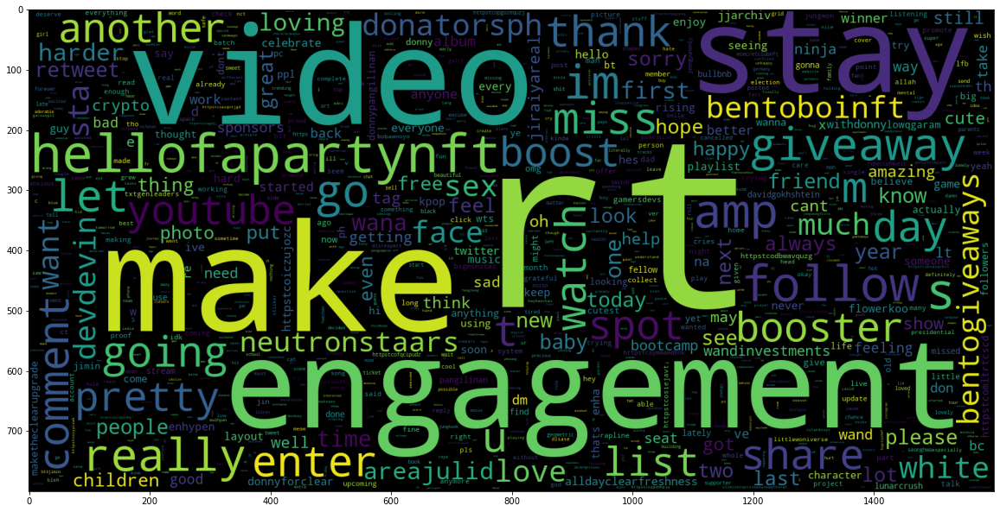

In [51]:
#plotting cloud of words for negative tweets
import matplotlib.pyplot as plt
from wordcloud import WordCloud


data_neg = [i for i in df_final[df_final['label']=='0']['text'].values]
flattened_neg  = [val for sublist in data_neg for val in sublist]

wc = WordCloud(max_words = 1000 , width = 1600 , height = 800,
               collocations=False).generate(" ".join(flattened_neg))
plt.figure(figsize = (20,20))
plt.imshow(wc)


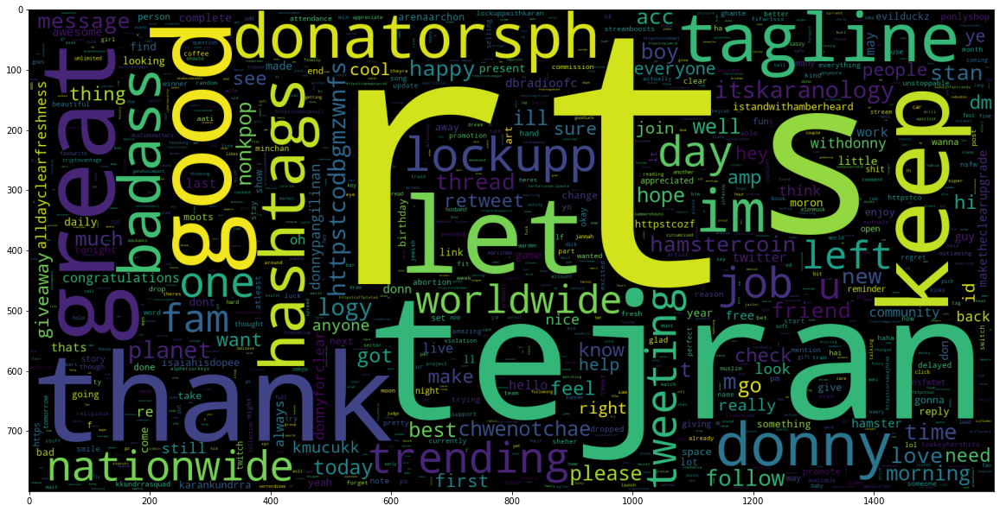

In [53]:
#plotting cloud of words for positive tweets

data_pos = [i for i in df_final[df_final['label']=='1']['text'].values]
flattened_pos  = [val for sublist in data_pos for val in sublist]

wc = WordCloud(max_words = 1000 , width = 1600 , height = 800,
              collocations=False).generate(" ".join(flattened_pos))
plt.figure(figsize = (20,20))
plt.imshow(wc)


In [67]:
X = df_final.text.astype(str)
y = df_final.label.astype(str)

In [68]:
# Separating the 95% data for training data and 5% for testing data
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(X, y ,test_size = 0.20, random_state =26105111)

In [70]:
#tfid vectorizer
from sklearn.feature_extraction.text import TfidfVectorizer

vectoriser = TfidfVectorizer(ngram_range=(1,2), max_features=500000)
vectoriser.fit(X_train)

print('No. of feature_words: ', len(vectoriser.get_feature_names()))

No. of feature_words:  23813


In [71]:
#transform the data

X_train = vectoriser.transform(X_train)
X_test  = vectoriser.transform(X_test)

In [73]:
def model_Evaluate(model):
    # Predict values for Test dataset
    y_pred = model.predict(X_test)
    # Print the evaluation metrics for the dataset.
    print(classification_report(y_test, y_pred))
    # Compute and plot the Confusion matrix
    cf_matrix = confusion_matrix(y_test, y_pred)
    categories = ['Negative','Positive']
    group_names = ['True Neg','False Pos', 'False Neg','True Pos']
    group_percentages = ['{0:.2%}'.format(value) for value in cf_matrix.flatten() / np.sum(cf_matrix)]
    labels = [f'{v1}n{v2}' for v1, v2 in zip(group_names,group_percentages)]
    labels = np.asarray(labels).reshape(2,2)
    sns.heatmap(cf_matrix, annot = labels, cmap = 'Blues',fmt = '',
    xticklabels = categories, yticklabels = categories)
    plt.xlabel("Predicted values", fontdict = {'size':14}, labelpad = 10)
    plt.ylabel("Actual values" , fontdict = {'size':14}, labelpad = 10)
    plt.title ("Confusion Matrix", fontdict = {'size':18}, pad = 20)
 


In [79]:
# sklearn
from sklearn.svm import LinearSVC
from sklearn.naive_bayes import BernoulliNB
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import confusion_matrix, classification_report
import seaborn as sns


              precision    recall  f1-score   support

           0       0.93      0.41      0.57       340
           1       0.66      0.97      0.79       407

    accuracy                           0.72       747
   macro avg       0.79      0.69      0.68       747
weighted avg       0.78      0.72      0.69       747



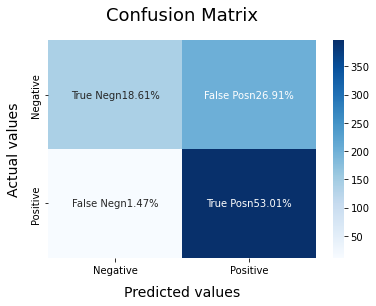

In [82]:
#model number 1
BNBmodel = BernoulliNB()
BNBmodel.fit(X_train, y_train)
model_Evaluate(BNBmodel)
y_pred1 = BNBmodel.predict(X_test)


              precision    recall  f1-score   support

           0       0.73      0.72      0.73       340
           1       0.77      0.78      0.78       407

    accuracy                           0.75       747
   macro avg       0.75      0.75      0.75       747
weighted avg       0.75      0.75      0.75       747



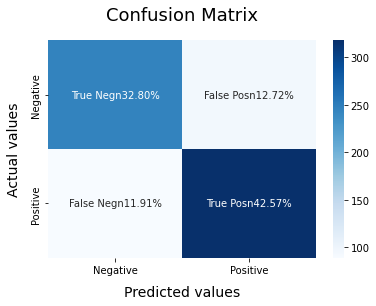

In [83]:
# model 2

SVCmodel = LinearSVC()
SVCmodel.fit(X_train, y_train)
model_Evaluate(SVCmodel)
y_pred2 = SVCmodel.predict(X_test)

              precision    recall  f1-score   support

           0       0.75      0.67      0.71       340
           1       0.75      0.81      0.78       407

    accuracy                           0.75       747
   macro avg       0.75      0.74      0.74       747
weighted avg       0.75      0.75      0.75       747



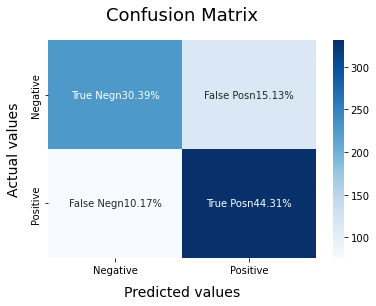

In [84]:
# Model-3

LRmodel = LogisticRegression(C = 2, max_iter = 1000, n_jobs=-1)
LRmodel.fit(X_train, y_train)
model_Evaluate(LRmodel)
y_pred3 = LRmodel.predict(X_test)